##**Notebook PC#08**
## Simple Recurrent Neural Network, Linear Predictor, MLP and LSTM for multi-step time series prediction.<BR>

**Professor:** Fernando J. Von Zuben <br>
**Aluno(a):** Ariel Góes de Castro <br>
**Aluno(a):** Francisco Germano Vogt

<span style="color:rgb(255,191,0)">
## AVISO:
## Para essa tarefa (PC08) existem dois arquivos. Cada um foi executado com um dos datasets. A Atividade (c) foi respondida em cada um deles separadamente
</span>

In [1]:
# Loading all the relevant libraries
from pandas import read_csv
from pandas import DataFrame
import numpy as np
import pandas as pd
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, SimpleRNN, LSTM, GRU
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
import math
import matplotlib.pyplot as plt

2024-06-10 15:39:05.718200: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-06-10 15:39:05.766055: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-10 15:39:05.766098: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-10 15:39:05.767288: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-06-10 15:39:05.775658: I tensorflow/core/platform/cpu_feature_guar

## **A base [unemployment rate] foi baixada no [link](https://fred.stlouisfed.org/series/UNRATE).**

In [2]:
# Structuring the dataset from a single time series, scaling and spliting into training / testing
def get_train_test(dataset, split_percent, time_steps, horizon):
    df = read_csv(dataset, usecols=[1], engine='python')
    data = np.array(df.values.astype('float32'))
    scaler = MinMaxScaler(feature_range=(0, 1))
    # There is a kind of data leakage in the next command
    data = scaler.fit_transform(data).flatten()
    n = len(data)
    df = DataFrame()
    for i in range(0,time_steps):
      df['t-' + str(time_steps-i-1)] = [data[j] for j in range(i, (len(data)-horizon-time_steps+i+1))]
    for i in range(1,horizon+1):
      df['t+' + str(i)] = [data[j] for j in range(time_steps+i-1, (len(data)-horizon+i))]
    print(df)
    df1 = df.copy()
    for i in range(1,horizon+1):
      df1 = df1.drop(['t+' + str(i)], axis = 1)
    dataX = np.array(df1) #separacao de dados de time_steps
    df2 = df['t+1']
    for i in range(2,horizon+1):
      df2 = pd.concat([df2, df['t+' + str(i)]], axis=1)
    datay = np.array(df2) #separacao de dados de horizon
    # Point for splitting data into train and test
    split = int(n*split_percent)
    X = dataX[range(split),:]
    y = datay[range(split)]
    Xt = dataX[split:,:]
    yt = datay[split:]
    return X, y, Xt, yt

time_steps = 11
horizon = 3
# Here you will decide which dataset to consider.
# X, y, Xt, yt = get_train_test('unemployment_rate.csv', 0.8, time_steps, horizon)
X, y, Xt, yt = get_train_test('monthly_sunspot.csv', 0.8, time_steps, horizon)

          t-10       t-9       t-8       t-7       t-6       t-5       t-4  \
0     0.228526  0.246651  0.275808  0.219464  0.334909  0.328999  0.373522   
1     0.246651  0.275808  0.219464  0.334909  0.328999  0.373522  0.261229   
2     0.275808  0.219464  0.334909  0.328999  0.373522  0.261229  0.299054   
3     0.219464  0.334909  0.328999  0.373522  0.261229  0.299054  0.297478   
4     0.334909  0.328999  0.373522  0.261229  0.299054  0.297478  0.624901   
...        ...       ...       ...       ...       ...       ...       ...   
2802  0.418046  0.423956  0.468085  0.373128  0.386525  0.500394  0.332151   
2803  0.423956  0.468085  0.373128  0.386525  0.500394  0.332151  0.200946   
2804  0.468085  0.373128  0.386525  0.500394  0.332151  0.200946  0.262017   
2805  0.373128  0.386525  0.500394  0.332151  0.200946  0.262017  0.317967   
2806  0.386525  0.500394  0.332151  0.200946  0.262017  0.317967  0.390859   

           t-3       t-2       t-1       t-0       t+1       t+

In [3]:
print(X.shape)
print(y.shape)

(2256, 11)
(2256, 3)


## **Implementing the simple recurrent neural network**

In [4]:
# Execute this cell or the cell associated with one of the other predictors. They are mutually exclusive.
def create_RNN(hidden_units, dense_units, input_shape, activation):
        model = Sequential()
        model.add(SimpleRNN(hidden_units, activation=activation[0], input_shape=input_shape))
        model.add(Dense(units=dense_units, activation=activation[1]))
        model.compile(loss='mean_squared_error', optimizer='adam')
        return model

def RNN_predictor (X, y, time_steps):
    model = create_RNN(hidden_units=30, dense_units=horizon, input_shape=(time_steps,1), activation=['tanh', 'tanh'])
    train_predict = model.fit(X, y, epochs=20, batch_size=1, verbose=2)
    return model

RNN_model = RNN_predictor(X, y, time_steps)

2024-06-10 15:39:08.121574: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-10 15:39:08.163185: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-10 15:39:08.163648: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

Epoch 1/20


2024-06-10 15:39:09.880093: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f3915b0ff60 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-06-10 15:39:09.880134: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce GTX 1650, Compute Capability 7.5
2024-06-10 15:39:09.887141: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-06-10 15:39:09.906244: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8904
I0000 00:00:1718044750.027004   63568 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


2256/2256 - 13s - loss: 0.0063 - 13s/epoch - 6ms/step
Epoch 2/20
2256/2256 - 12s - loss: 0.0048 - 12s/epoch - 5ms/step
Epoch 3/20
2256/2256 - 11s - loss: 0.0047 - 11s/epoch - 5ms/step
Epoch 4/20
2256/2256 - 11s - loss: 0.0047 - 11s/epoch - 5ms/step
Epoch 5/20
2256/2256 - 12s - loss: 0.0047 - 12s/epoch - 5ms/step
Epoch 6/20
2256/2256 - 13s - loss: 0.0047 - 13s/epoch - 6ms/step
Epoch 7/20
2256/2256 - 13s - loss: 0.0046 - 13s/epoch - 6ms/step
Epoch 8/20
2256/2256 - 13s - loss: 0.0046 - 13s/epoch - 6ms/step
Epoch 9/20
2256/2256 - 13s - loss: 0.0046 - 13s/epoch - 6ms/step
Epoch 10/20
2256/2256 - 13s - loss: 0.0046 - 13s/epoch - 6ms/step
Epoch 11/20
2256/2256 - 13s - loss: 0.0046 - 13s/epoch - 6ms/step
Epoch 12/20
2256/2256 - 12s - loss: 0.0045 - 12s/epoch - 5ms/step
Epoch 13/20
2256/2256 - 14s - loss: 0.0046 - 14s/epoch - 6ms/step
Epoch 14/20
2256/2256 - 13s - loss: 0.0045 - 13s/epoch - 6ms/step
Epoch 15/20
2256/2256 - 11s - loss: 0.0045 - 11s/epoch - 5ms/step
Epoch 16/20
2256/2256 - 12s - 

In [5]:
# [Do not run this cell] or [Upload the PNG file and then run].
# Configuration of the simple RNN
from IPython.display import Image
Image("RNN_info_flow.png", width = 600, height = 300)

FileNotFoundError: No such file or directory: 'RNN_info_flow.png'

FileNotFoundError: No such file or directory: 'RNN_info_flow.png'

<IPython.core.display.Image object>

In [6]:
wx = RNN_model.get_weights()[0]
wh = RNN_model.get_weights()[1]
bh = RNN_model.get_weights()[2]
wy = RNN_model.get_weights()[3]
by = RNN_model.get_weights()[4]
print(wx.shape)
print(wh.shape)
print(bh.shape)
print(wy.shape)
print(by.shape)

(1, 30)
(30, 30)
(30,)
(30, 3)
(3,)


## **Implementing a linear predictor**

In [7]:
# Execute this cell or the cell associated with one of the other predictors. They are mutually exclusive.
def linear_predictor(X,y):
    model = LinearRegression()
    train_predict = model.fit(X, y)
    print(model.coef_)
    print(model.intercept_)

    return model

linear_model = linear_predictor(X,y)

[[-0.03231123 -0.03466079  0.07275806  0.00478126 -0.01082122  0.06693879
   0.04085743  0.08718739  0.07405274  0.13080618  0.55684185]
 [-0.0807448  -0.01733893  0.01364096  0.08068267  0.00291306  0.03024404
   0.09379473  0.09038369  0.12686108  0.15160792  0.43763566]
 [-0.10533386 -0.04564691  0.02615285  0.02253849  0.08277353  0.03709108
   0.05409256  0.13282865  0.12137757  0.19044915  0.3907065 ]]
[0.00763167 0.01236641 0.01638973]


## **Implementing the multilayer perceptron neural network (MLP)**

In [8]:
# Execute this cell or the cell associated with one of the other predictors. They are mutually exclusive.
def MLP_predictor():
  model = tf.keras.models.Sequential([
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(80, activation=tf.nn.tanh),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(horizon, activation='linear')
  ])
  model.compile(optimizer='adam', loss='mean_squared_error')
  train_predict = model.fit(X, y, epochs=100)
  model.summary()

  return model

MLP_model = MLP_predictor()

Epoch 1/100
71/71 [==============================] - 2s 2ms/step - loss: 0.0185
Epoch 2/100
71/71 [==============================] - 0s 2ms/step - loss: 0.0093
Epoch 3/100
71/71 [==============================] - 0s 3ms/step - loss: 0.0071
Epoch 4/100
71/71 [==============================] - 0s 3ms/step - loss: 0.0063
Epoch 5/100
71/71 [==============================] - 0s 2ms/step - loss: 0.0060
Epoch 6/100
71/71 [==============================] - 0s 2ms/step - loss: 0.0058
Epoch 7/100
71/71 [==============================] - 0s 2ms/step - loss: 0.0054
Epoch 8/100
71/71 [==============================] - 0s 2ms/step - loss: 0.0054
Epoch 9/100
71/71 [==============================] - 0s 2ms/step - loss: 0.0053
Epoch 10/100
71/71 [==============================] - 0s 2ms/step - loss: 0.0053
Epoch 11/100
71/71 [==============================] - 0s 2ms/step - loss: 0.0053
Epoch 12/100
71/71 [==============================] - 0s 3ms/step - loss: 0.0052
Epoch 13/100
71/71 [=================

## **Implementing the long short-term memory network (LSTM)**

In [9]:
def LSTM_predictor(X, y, time_steps):
    X1 = X.reshape(X.shape[0],time_steps,1)
    model=Sequential()
    model.add(LSTM(25,input_shape=(time_steps,1)))
    model.add(Dense(horizon,activation='linear'))
    model.compile(loss='mean_squared_error',optimizer='adam')

    train_predict = model.fit(X1,y,epochs=200,verbose=2)

    return model

LSTM_model = LSTM_predictor(X, y, time_steps)
print(LSTM_model.summary())

Epoch 1/200
71/71 - 2s - loss: 0.0120 - 2s/epoch - 32ms/step
Epoch 2/200
71/71 - 0s - loss: 0.0055 - 254ms/epoch - 4ms/step
Epoch 3/200
71/71 - 0s - loss: 0.0053 - 259ms/epoch - 4ms/step
Epoch 4/200
71/71 - 0s - loss: 0.0051 - 257ms/epoch - 4ms/step
Epoch 5/200
71/71 - 0s - loss: 0.0050 - 248ms/epoch - 3ms/step
Epoch 6/200
71/71 - 0s - loss: 0.0049 - 240ms/epoch - 3ms/step
Epoch 7/200
71/71 - 0s - loss: 0.0048 - 244ms/epoch - 3ms/step
Epoch 8/200
71/71 - 0s - loss: 0.0047 - 244ms/epoch - 3ms/step
Epoch 9/200
71/71 - 0s - loss: 0.0046 - 233ms/epoch - 3ms/step
Epoch 10/200
71/71 - 0s - loss: 0.0046 - 253ms/epoch - 4ms/step
Epoch 11/200
71/71 - 0s - loss: 0.0046 - 238ms/epoch - 3ms/step
Epoch 12/200
71/71 - 0s - loss: 0.0045 - 219ms/epoch - 3ms/step
Epoch 13/200
71/71 - 0s - loss: 0.0045 - 233ms/epoch - 3ms/step
Epoch 14/200
71/71 - 0s - loss: 0.0045 - 222ms/epoch - 3ms/step
Epoch 15/200
71/71 - 0s - loss: 0.0045 - 215ms/epoch - 3ms/step
Epoch 16/200
71/71 - 0s - loss: 0.0046 - 225ms/epoc

In [10]:
def print_error(trainY, testY, train_predict, test_predict,i):
    # Error of predictions
    train_rmse = math.sqrt(mean_squared_error(trainY, train_predict))
    test_rmse = math.sqrt(mean_squared_error(testY, test_predict))
    # Print RMSE
    print('t+%d RMSE train: %.3f RMSE' % (i+1, train_rmse))
    print('t+%d RMSE test: %.3f RMSE' % (i+1, test_rmse))
    return [train_rmse, test_rmse]


def RMSE(train_predict, test_predict):
  rmse = []
  for i in range(horizon):
    if(horizon == 1):
      y1_pred = train_predict
      y1_pred_t = test_predict
      y1 = y
      y1_t = yt
    elif(horizon > 1):
      y1_pred = train_predict[:,i]
      y1_pred_t = test_predict[:,i]
      y1 = y[:,i]
      y1_t = yt[:,i]

    erro = print_error(y1, y1_t, y1_pred, y1_pred_t,i)
    rmse.append(erro)

  # Create a DataFrame from the rmse values for each horizon
  df = pd.DataFrame(rmse)
  df.columns = ['train', 'test']
  return df


In [11]:
# Plot the predictions together with the actual values
def plot_result(trainY, testY, train_predict, test_predict,i):
    actual = np.append(trainY, testY)
    predictions = np.append(train_predict, test_predict)
    rows = len(actual)
    plt.figure(figsize=(30, 6), dpi=300)
    plt.plot(range(rows), actual)
    plt.plot(range(rows), predictions)
    plt.axvline(x=len(trainY), color='r')
    plt.legend(['Actual', 'Predictions'])
    plt.xlabel('Time steps')
    plt.ylabel('Actual and Predicted Values')
    plt.title('t+%d Predition (The Red Line Separates The Training And Test Examples)' % (i+1))
    plt.grid(True)

def plot_predict(train_predict, test_predict, y, yt):
  for i in range(horizon):
    if(horizon == 1):
      y1_pred = train_predict
      y1_pred_t = test_predict
      y1 = y
      y1_t = yt
    elif(horizon > 1):
      y1_pred = train_predict[:,i]
      y1_pred_t = test_predict[:,i]
      y1 = y[:,i]
      y1_t = yt[:,i]
    plot_result(y1, y1_t, y1_pred, y1_pred_t,i)


***** RNN MODEL *****
18/18 [==============================] - 0s 3ms/step
t+1 RMSE train: 0.059 RMSE
t+1 RMSE test: 0.078 RMSE
t+2 RMSE train: 0.067 RMSE
t+2 RMSE test: 0.091 RMSE
t+3 RMSE train: 0.073 RMSE
t+3 RMSE test: 0.097 RMSE


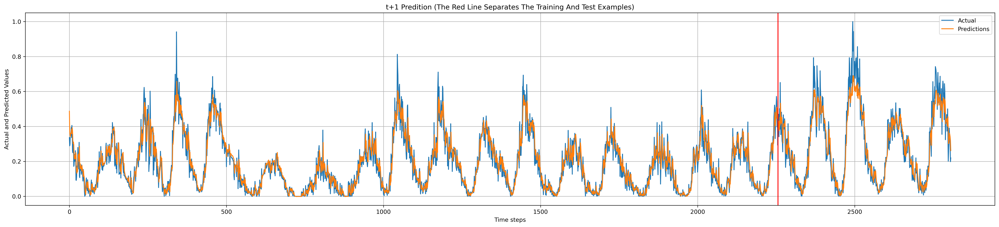

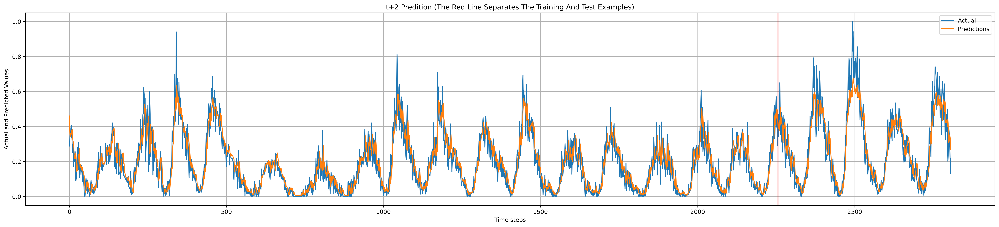

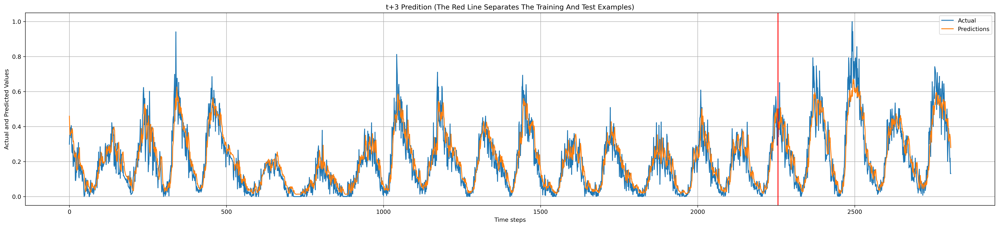

In [12]:
print ('***** RNN MODEL *****')
train_predict = RNN_model.predict(X)
test_predict = RNN_model.predict(Xt)
df1 = RMSE(train_predict, test_predict)
plot_predict(train_predict, test_predict, y, yt)

***** LINEAR MODEL *****
t+1 RMSE train: 0.058 RMSE
t+1 RMSE test: 0.073 RMSE
t+2 RMSE train: 0.067 RMSE
t+2 RMSE test: 0.087 RMSE
t+3 RMSE train: 0.071 RMSE
t+3 RMSE test: 0.093 RMSE


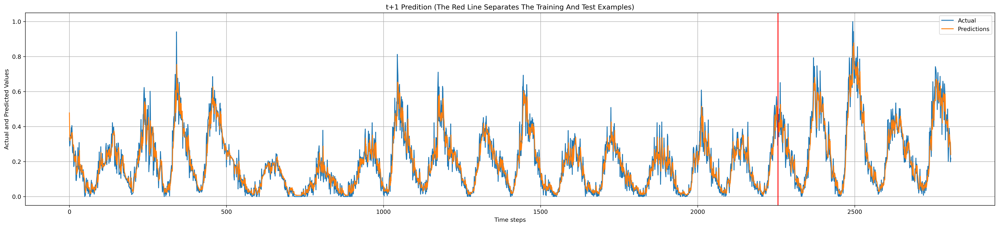

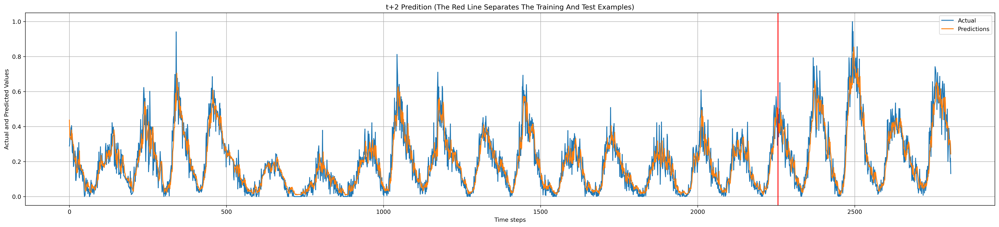

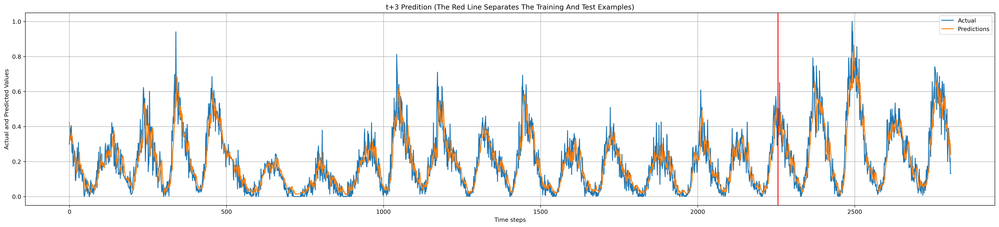

In [13]:
print ('***** LINEAR MODEL *****')
train_predict = linear_model.predict(X)
test_predict = linear_model.predict(Xt)
df2 = RMSE(train_predict, test_predict)
plot_predict(train_predict, test_predict, y, yt)

***** MLP MODEL *****
18/18 [==============================] - 0s 1ms/step
t+1 RMSE train: 0.059 RMSE
t+1 RMSE test: 0.073 RMSE
t+2 RMSE train: 0.067 RMSE
t+2 RMSE test: 0.087 RMSE
t+3 RMSE train: 0.072 RMSE
t+3 RMSE test: 0.095 RMSE


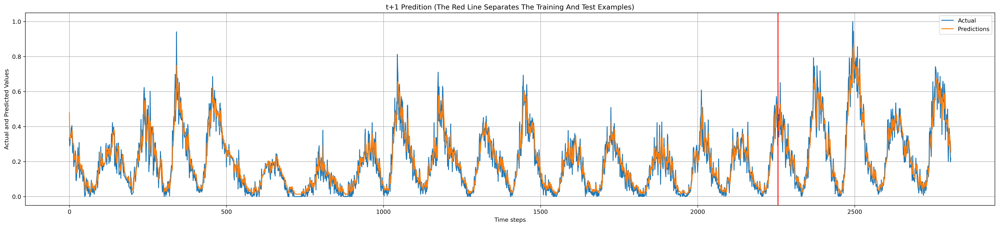

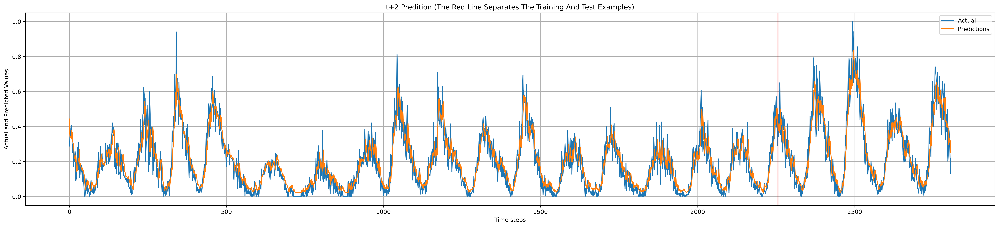

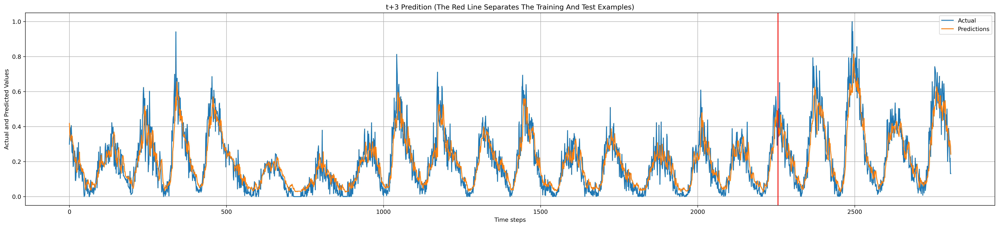

In [14]:
print ('***** MLP MODEL *****')
train_predict = MLP_model.predict(X)
test_predict = MLP_model.predict(Xt)
df3 = RMSE(train_predict, test_predict)
plot_predict(train_predict, test_predict, y, yt)

***** LSTM MODEL *****
18/18 [==============================] - 0s 2ms/step
t+1 RMSE train: 0.058 RMSE
t+1 RMSE test: 0.076 RMSE
t+2 RMSE train: 0.066 RMSE
t+2 RMSE test: 0.089 RMSE
t+3 RMSE train: 0.070 RMSE
t+3 RMSE test: 0.096 RMSE


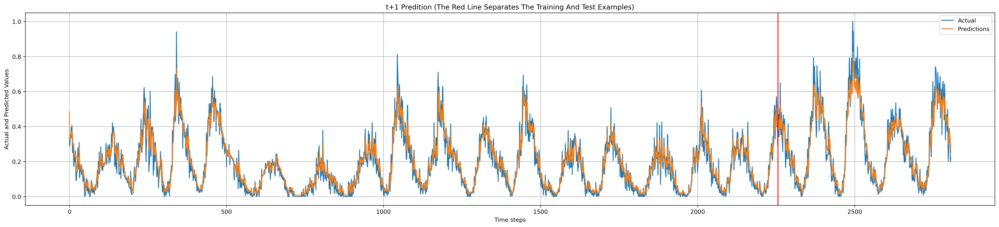

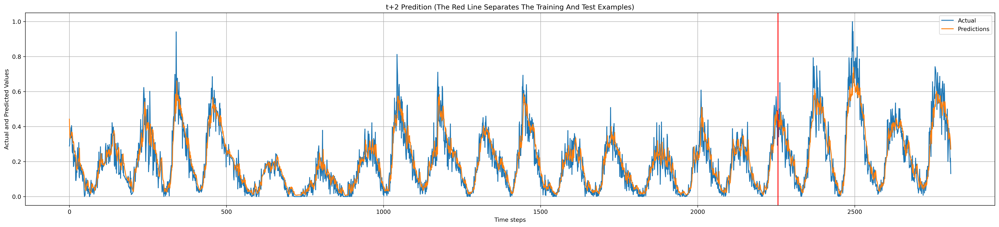

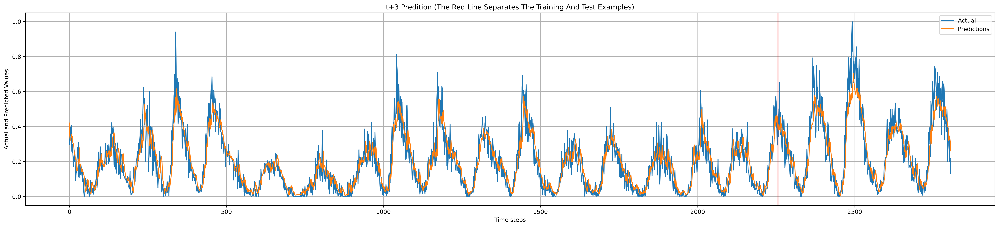

In [15]:
print ('***** LSTM MODEL *****')
train_predict = LSTM_model.predict(X)
test_predict = LSTM_model.predict(Xt)
df4 = RMSE(train_predict, test_predict)
plot_predict(train_predict, test_predict, y, yt)

In [16]:
# Plot the prediction error
def plot_result2(trainY, testY, train_predict, test_predict,i):
    actual = np.append(trainY, testY)
    predictions = np.append(train_predict, test_predict)
    rows = len(actual)
    plt.figure(figsize=(30, 6), dpi=300)
    plt.plot(range(rows), actual - predictions)
    plt.axvline(x=len(trainY), color='r')
    plt.xlabel('Time steps')
    plt.ylabel('Actual minus Predicted Values')
    plt.title('t+%d Predition Error (The Red Line Separates The Training And Test Examples)' % (i+1))
    plt.ylim(-0.5, +1.0) # Please, set the interval appropriately, considering all the graphs.
    plt.grid(True)

def plot_error_predict(train_predict, test_predict, y, yt):
    for i in range(horizon):
      if(horizon == 1):
        y1_pred = train_predict
        y1_pred_t = test_predict
        y1 = y
        y1_t = yt
      elif(horizon > 1):
        y1_pred = train_predict[:,i]
        y1_pred_t = test_predict[:,i]
        y1 = y[:,i]
        y1_t = yt[:,i]
      plot_result2(y1, y1_t, y1_pred, y1_pred_t,i)

***** RNN MODEL *****
18/18 [==============================] - 0s 2ms/step


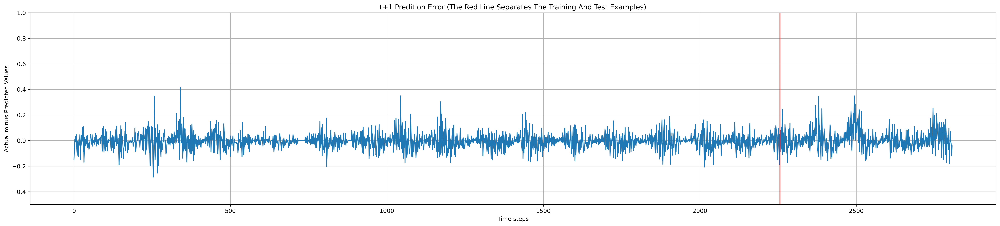

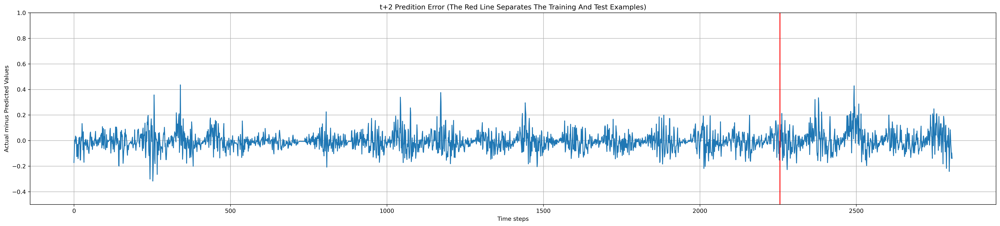

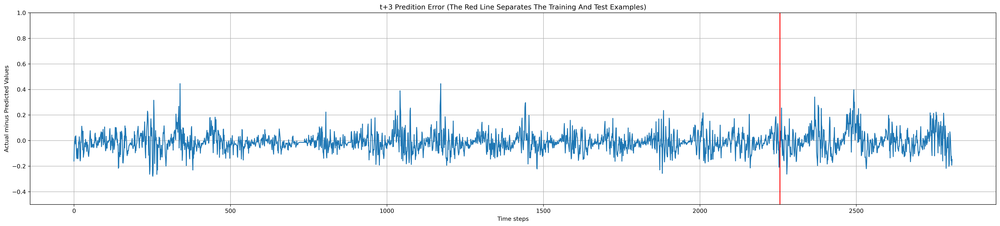

In [17]:
print ('***** RNN MODEL *****')
train_predict = RNN_model.predict(X)
test_predict = RNN_model.predict(Xt)
plot_error_predict(train_predict, test_predict, y, yt)


***** LINEAR MODEL *****


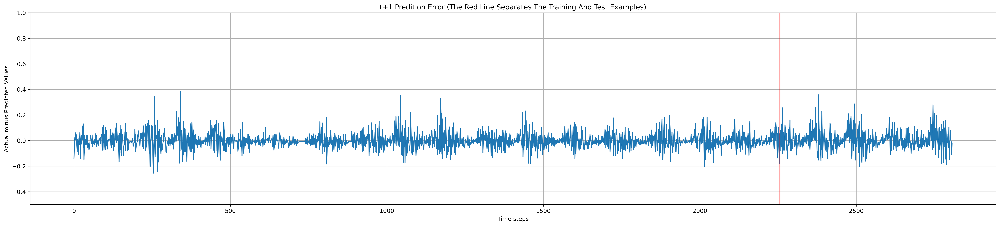

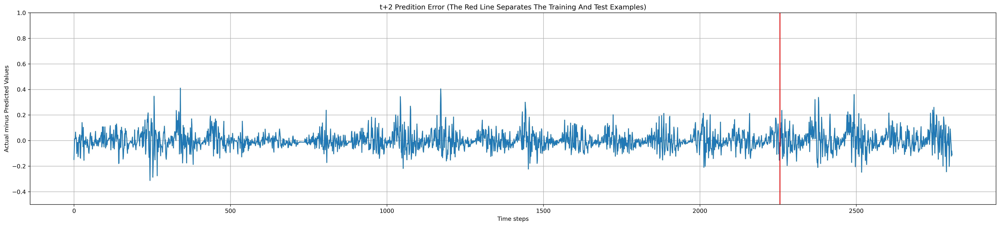

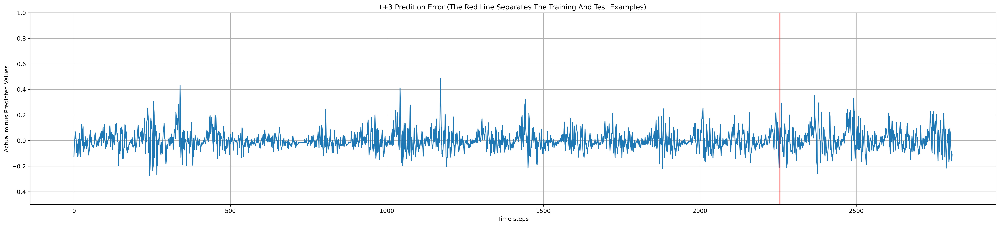

In [18]:
print ('***** LINEAR MODEL *****')
train_predict = linear_model.predict(X)
test_predict = linear_model.predict(Xt)
plot_error_predict(train_predict, test_predict, y, yt)

***** MLP MODEL *****
18/18 [==============================] - 0s 2ms/step


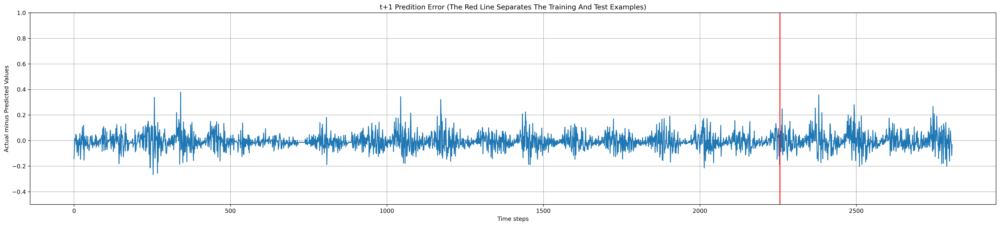

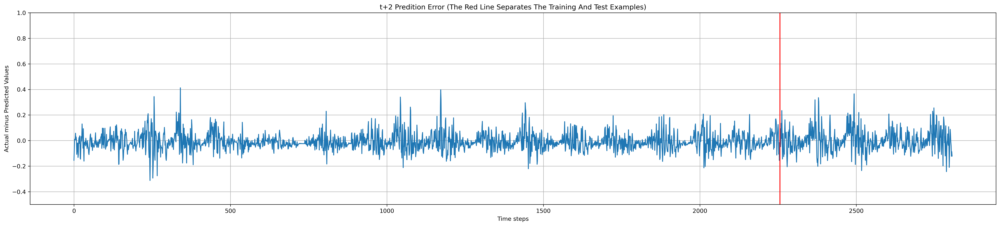

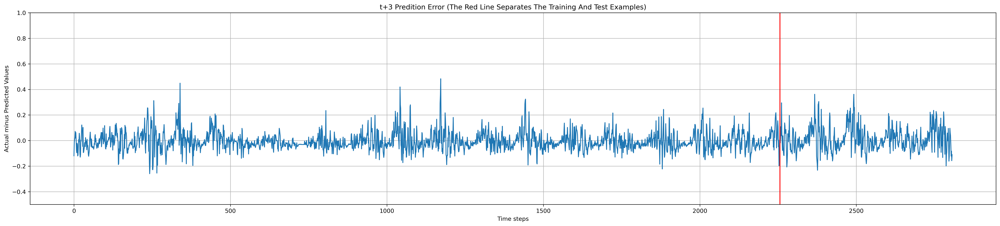

In [19]:
print ('***** MLP MODEL *****')
train_predict = MLP_model.predict(X)
test_predict = MLP_model.predict(Xt)
plot_error_predict(train_predict, test_predict, y, yt)

***** LSTM MODEL *****
18/18 [==============================] - 0s 1ms/step


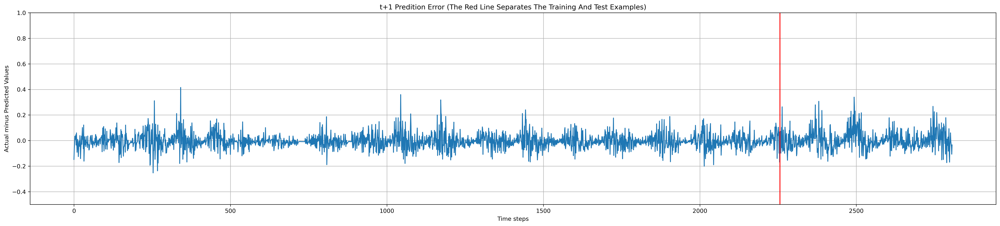

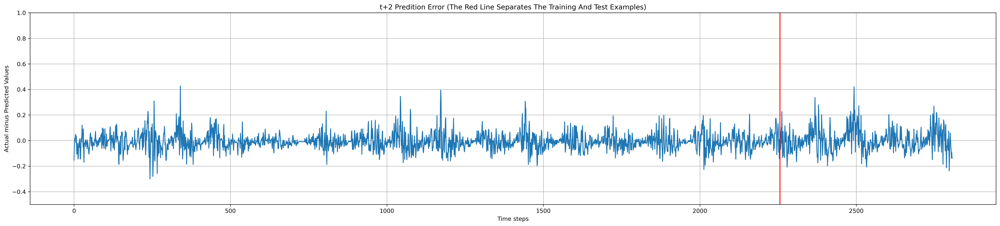

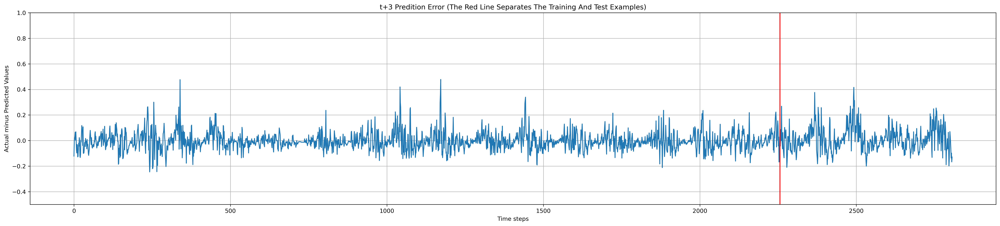

In [20]:
print ('***** LSTM MODEL *****')
train_predict = LSTM_model.predict(X)
test_predict = LSTM_model.predict(Xt)
plot_error_predict(train_predict, test_predict, y, yt)

## **Exhibit a dataframe with the final results for each predictor**

In [21]:
DF_results = pd.concat([df1, df2, df3, df4], axis=1, keys=['RNN', 'LINEAR', 'MLP', 'LSTM'])
DF_results.index = ['t+1', 't+2', 't+3']
DF_results

RNN              LINEAR                 MLP                LSTM  \
        train      test     train      test     train      test     train   
t+1  0.059132  0.078349  0.058257  0.073480  0.058694  0.073313  0.057942   
t+2  0.067297  0.090893  0.066630  0.087041  0.067202  0.086924  0.066092   
t+3  0.072798  0.096989  0.071136  0.093434  0.071708  0.095033  0.069650   

               
         test  
t+1  0.075756  
t+2  0.089097  
t+3  0.095710

## **Use the SimpleRNN model to make a search for the best [time_steps].**

In [22]:
time_steps = [1, 2, 7, 11, 50]
horizon = 3
DF1 = pd.DataFrame()

for timesteps in time_steps:
    X, y, Xt, yt = get_train_test('monthly_sunspot.csv', 0.8, timesteps, horizon)
    RNN_model = RNN_predictor(X, y, timesteps)
    train_predict = RNN_model.predict(X)
    test_predict = RNN_model.predict(Xt)
    rmse  = RMSE(train_predict, test_predict)
    rmse.columns = pd.MultiIndex.from_product([[timesteps], rmse.columns])
    DF1 = pd.concat([DF1, rmse], axis=1)

           t-0       t+1       t+2       t+3
0     0.228526  0.246651  0.275808  0.219464
1     0.246651  0.275808  0.219464  0.334909
2     0.275808  0.219464  0.334909  0.328999
3     0.219464  0.334909  0.328999  0.373522
4     0.334909  0.328999  0.373522  0.261229
...        ...       ...       ...       ...
2812  0.390859  0.358944  0.323877  0.282900
2813  0.358944  0.323877  0.282900  0.198188
2814  0.323877  0.282900  0.198188  0.219858
2815  0.282900  0.198188  0.219858  0.131206
2816  0.198188  0.219858  0.131206  0.131600

[2817 rows x 4 columns]
Epoch 1/20
2256/2256 - 6s - loss: 0.0074 - 6s/epoch - 3ms/step
Epoch 2/20
2256/2256 - 4s - loss: 0.0053 - 4s/epoch - 2ms/step
Epoch 3/20
2256/2256 - 4s - loss: 0.0052 - 4s/epoch - 2ms/step
Epoch 4/20
2256/2256 - 5s - loss: 0.0052 - 5s/epoch - 2ms/step
Epoch 5/20
2256/2256 - 5s - loss: 0.0052 - 5s/epoch - 2ms/step
Epoch 6/20
2256/2256 - 5s - loss: 0.0052 - 5s/epoch - 2ms/step
Epoch 7/20
2256/2256 - 4s - loss: 0.0052 - 4s/epoch - 2ms

In [23]:
DF1.index = ['t+1', 't+2', 't+3']
DF1

1                   2                   7                   11  \
        train      test     train      test     train      test     train   
t+1  0.064647  0.089717  0.060792  0.086344  0.059249  0.084868  0.059044   
t+2  0.072439  0.098444  0.070173  0.099513  0.067426  0.097649  0.066649   
t+3  0.077348  0.103087  0.074577  0.104629  0.072650  0.105064  0.071098   

                     50            
         test     train      test  
t+1  0.077517  0.058464  0.082247  
t+2  0.092797  0.064761  0.093432  
t+3  0.099212  0.069786  0.097672

## **Use the LSTM model to make a search for the best [time_steps].**

In [24]:
time_steps = [1, 2, 7, 11, 50]
horizon = 3
DF2 = pd.DataFrame()

for timesteps in time_steps:
    X, y, Xt, yt = get_train_test('monthly_sunspot.csv', 0.8, timesteps, horizon)
    LSTM_model = LSTM_predictor(X, y, timesteps)
    train_predict = LSTM_model.predict(X)
    test_predict = LSTM_model.predict(Xt)
    rmse  = RMSE(train_predict, test_predict)
    rmse.columns = pd.MultiIndex.from_product([[timesteps], rmse.columns])
    DF2 = pd.concat([DF2, rmse], axis=1)

           t-0       t+1       t+2       t+3
0     0.228526  0.246651  0.275808  0.219464
1     0.246651  0.275808  0.219464  0.334909
2     0.275808  0.219464  0.334909  0.328999
3     0.219464  0.334909  0.328999  0.373522
4     0.334909  0.328999  0.373522  0.261229
...        ...       ...       ...       ...
2812  0.390859  0.358944  0.323877  0.282900
2813  0.358944  0.323877  0.282900  0.198188
2814  0.323877  0.282900  0.198188  0.219858
2815  0.282900  0.198188  0.219858  0.131206
2816  0.198188  0.219858  0.131206  0.131600

[2817 rows x 4 columns]
Epoch 1/200
71/71 - 2s - loss: 0.0331 - 2s/epoch - 31ms/step
Epoch 2/200
71/71 - 0s - loss: 0.0162 - 236ms/epoch - 3ms/step
Epoch 3/200
71/71 - 0s - loss: 0.0129 - 234ms/epoch - 3ms/step
Epoch 4/200
71/71 - 0s - loss: 0.0098 - 223ms/epoch - 3ms/step
Epoch 5/200
71/71 - 0s - loss: 0.0070 - 224ms/epoch - 3ms/step
Epoch 6/200
71/71 - 0s - loss: 0.0057 - 219ms/epoch - 3ms/step
Epoch 7/200
71/71 - 0s - loss: 0.0053 - 212ms/epoch - 3ms/s

In [25]:
DF2.index = ['t+1', 't+2', 't+3']
DF2

1                   2                   7                   11  \
        train      test     train      test     train      test     train   
t+1  0.063097  0.083504  0.060273  0.080745  0.058579  0.074885  0.057832   
t+2  0.072311  0.100905  0.069147  0.095372  0.066904  0.089815  0.065500   
t+3  0.077001  0.107442  0.073497  0.101411  0.071599  0.098586  0.069520   

                     50            
         test     train      test  
t+1  0.074457  0.054322  0.078172  
t+2  0.088440  0.058285  0.093112  
t+3  0.095099  0.059799  0.096736

<font color="green">
(a)	Explique o papel dos parâmetros de projeto [time_steps] e [horizon].
</font>

**Resposta:**<BR>

No contexto de séries temporais, os dados de entrada consistem em uma sequência de medidas de intervalo de tempo. Para entrada no modelo de predição temporal, podemos configurar um número de dados observados no passado, isto é os *time_steps* de dados históricos para prever saídas futuras. Assim,o modelo tenta prever os valores para a próxima saída em etapas do horizonte no futuro. Neste caso, o horizonte é definido como 3 em todos os algoritmos, em que os diferentes modelos prevêm as taxas de desemprego para os próximos três períodos. Ou seja, o horizonte (*horizon*) refere-se ao número de etapas futuras que o modelo está tentando prever. Essencialmente, *horizon* define o quão longe o modelo pretende fazer uma previsão. Se a rede for recorrente, cada predição é retroalimentada até o valor do horizonte. Enquanto que, em rede não-recorrentes, pode existir linhas de derivação de atraso e o modelo prevê diretamente K passos no futuro.


<font color="green">
(b)	Qual a diferença no uso do parâmetro [time_steps] no caso dos preditores não-recorrentes e no caso do bloco LSTM?
</font>

**Resposta:**<BR>

A diferença está em como os modelos lidam com dados passados para predição. Os modelos não-recorrentes tratam o **time_steps** como uma única janela, tratando os dados como features independentes na predição sem considerar relações temporais subjacentes com os dados mais antigos no histórico. Já, modelos recorrentes (como a LSTM), atuam como um modelo sequencial, processando informações uma etapa de cada vez. Uma LSTM utiliza o **time_steps** para definir o número de pontos de dados anteriores que considera para cada previsão, levando em consideração a ordem e as dependências temporais entre esses pontos de dados anteriores por meio de seu mecanismo de memória interna. Isso acontece, porque na prática, um bloco LSTM é um bloco de redes recorrentes e essas, por sua vez, possuem duas dinâmicas: (i) dos pesos e (ii) da própria rede. Após ajustar os pesos, ainda existem a dinâmica da rede, estimulada pelos dados, que é aproximada.


<font color="green">
(c)	Qual modelo de predição levou a um melhor desempenho junto aos dados de teste em cada caso?
</font>

**Resposta:**<BR>

A tabela abaixo mostra o Root Mean Squared Error (RMSE) para diferentes abordagens de previsão em uma tarefa de previsão de série temporal. Ele compara o desempenho dos modelos RNN (Rede Neural Recorrente), Regressão Linear, MLP (Perceptron Multicamada) e LSTM (Long Short-Term Memory) para os dados de treinamento e teste.

**MONTHLY SUNSPOT**

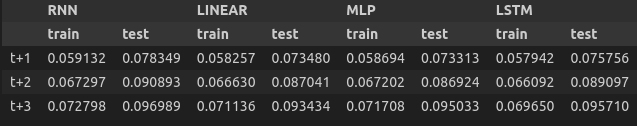

Nesse caso, o modelo Linear superou consistentemente os outros modelos em todos os intervalos de tempo (t+1, t+2, t+3) no conjunto de dados de teste. Isto sugere que, para este conjunto de dados e problema específico, o modelo linear forneceu melhores previsões do que os modelos RNN, MLP e LSTM.

O desempenho superior do modelo linear em relação aos modelos RNN, MLP e LSTM neste caso pode ser atribuído a várias razões:

_Simplicidade do Modelo:_ Modelos lineares são mais simples em comparação com RNNs, MLPs e LSTMs. Eles têm menos parâmetros para aprender e, em alguns casos, podem ser mais adequados para conjuntos de dados onde a relação entre variáveis de entrada e saída é linear ou quase linear.

_Melhor Ajuste aos Dados:_ Em alguns casos, os dados podem se ajustar melhor a um modelo linear do que a modelos não lineares. Se os padrões nos dados forem melhor descritos por uma relação linear, os modelos lineares podem produzir previsões mais precisas.

Já entre os modelos recorrentes, a RNN simples neste database desempenhou levemente inferior ao LSTM.

<font color="green">
(d)	Ao se variar o [horizon], apresente uma hipótese para a perda de desempenho conforme [horizon] cresce de 1 até 3, comportamento produzido por todos os modelos de predição, nos dois casos de estudo.
</font>

**Resposta:**<BR>

A cada predição realiza no futuro, existe um erro associado do valor de saída. Conforme eu aumento o tamanho do horizonte a ser visualizado no futuro, o erro se acumula. Por exemplo, assumindo um *horizon=5* e prever o próximo valor futuro, vou realimentar esse valor para a próxima entrada, que servirá como base para prever o próximo valor, e assim por diante. Portanto, quanto maior a janela de horizonte desejada, maior tende a ser o erro de previsão.

<font color="green">
(e)	Ao se variar o [time_steps] especificamente para os modelos SimpleRNN e LSTM, procure explicar o comportamento observado em cada caso de estudo.
</font>

**Resposta:**<BR>

Variações de time_steps podem afetar o comportamento dos modelos RNN e LSTM em geral:

**Tabela do dataset "MONTHLY SUNSPOT" (Melhor Desempenho do RNN)**

_RNN:_ O desempenho do modelo RNN foi melhor em todos os casos.

_LSTM:_ Mesmo que o LSTM seja uma extensão do RNN projetada para lidar melhor com dependências de longo prazo, ele pode não ser tão eficaz quanto um RNN simples para sequências de dados mais curtas. Isso pode ser devido à complexidade adicional do LSTM, o que o torna mais suscetível a overfitting em dados de sequência curta. Portanto, conforme o número de time steps aumenta, o LSTM pode não melhorar significativamente em comparação com o RNN.

_Comportamento Esperado:_ Espera-se que o desempenho do LSTM seja mais próximo do RNN à medida que o número de time steps diminui. No entanto, se o conjunto de dados for relativamente simples ou não tiver dependências de longo prazo, o RNN pode continuar superando o LSTM devido à sua simplicidade.

**Tabela do dataset "UNEMPLOYMENT RATE" (Melhor Desempenho Linear)**

_RNN e LSTM:_ Embora o RNN e o LSTM tenham um desempenho relativamente semelhante, ambos ficam atrás do modelo linear em todos os casos.

_Comportamento Esperado para LSTM:_ O desempenho do LSTM pode melhorar à medida que o número de time steps aumenta, pois ele é projetado para capturar dependências de longo prazo. No entanto, mesmo com o aumento do número de time steps, o LSTM não superou o modelo linear. Isso sugere que o conjunto de dados pode ser melhor modelado por uma relação linear.

_Comportamento Esperado para RNN:_ Assim como na primeira tabela, o RNN pode superar o LSTM devido à simplicidade e à capacidade de generalização em problemas onde as dependências temporais são simples ou de curto prazo.